In [1]:
import pycaret
pycaret.__version__

'3.2.0'

## Load Data

In [2]:
from pycaret.datasets import get_data
data = get_data('airline')

Period
1949-01    112.0
1949-02    118.0
1949-03    132.0
1949-04    129.0
1949-05    121.0
Freq: M, Name: Number of airline passengers, dtype: float64

<AxesSubplot: xlabel='Period'>

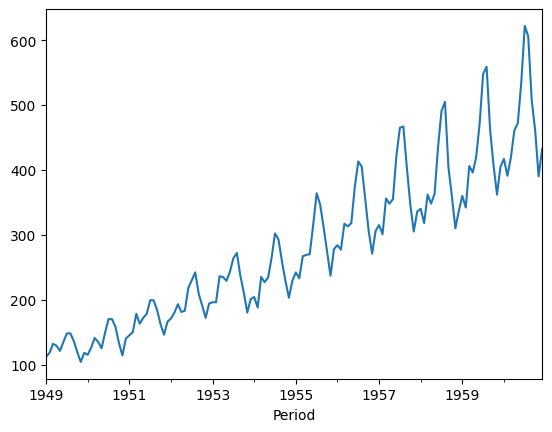

In [3]:
data.plot()

## Main

Setup ➡️ Check Stats ➡️ Compare Models ➡️ Analyze Model ➡️ Prediction

In [4]:
from pycaret.time_series import TSForecastingExperiment
exp = TSForecastingExperiment()

### Setup

In [5]:
exp.setup(data, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,Number of airline passengers
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(144, 1)"
5,Transformed data shape,"(144, 1)"
6,Transformed train set shape,"(141, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


### Check Stats

In [6]:
exp.check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,144.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,280.298611
3,Summary,Statistics,Transformed,Median,,265.5
4,Summary,Statistics,Transformed,Standard Deviation,,119.966317
5,Summary,Statistics,Transformed,Variance,,14391.917201
6,Summary,Statistics,Transformed,Kurtosis,,-0.364942
7,Summary,Statistics,Transformed,Skewness,,0.58316
8,Summary,Statistics,Transformed,# Distinct Values,,118.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",1606.083817


### Compare Models

In [7]:
exp.models()

,Name,Reference,Turbo
ID,,,
naive,Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
grand_means,Grand Means Forecaster,sktime.forecasting.naive.NaiveForecaster,True
snaive,Seasonal Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
polytrend,Polynomial Trend Forecaster,sktime.forecasting.trend.PolynomialTrendForeca...,True
arima,ARIMA,sktime.forecasting.arima.ARIMA,True
auto_arima,Auto ARIMA,sktime.forecasting.arima.AutoARIMA,True
exp_smooth,Exponential Smoothing,sktime.forecasting.exp_smoothing.ExponentialSm...,True
ets,ETS,sktime.forecasting.ets.AutoETS,True
theta,Theta Forecaster,sktime.forecasting.theta.ThetaForecaster,True


In [8]:
best = exp.compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
stlf,STLF,0.4136,0.4530,12.7373,15.8272,0.0262,0.0261,0.2016,0.0200
ets,ETS,0.4912,0.5541,15.0952,19.3115,0.0318,0.0316,-0.4465,0.8667
exp_smooth,Exponential Smoothing,0.4929,0.5560,15.1476,19.3788,0.0320,0.0317,-0.4604,0.7233
arima,ARIMA,0.6964,0.7110,21.3757,24.7774,0.0447,0.0456,-0.5495,1.0933
auto_arima,Auto ARIMA,0.7136,0.6945,21.9389,24.2138,0.0459,0.0464,-0.5454,7.3700
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.8658,0.8362,26.7826,29.3947,0.0516,0.0536,0.1501,0.1733
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,0.8904,0.8722,27.5266,30.6243,0.0534,0.0555,-0.0092,0.1400
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,0.8905,0.8722,27.5270,30.6246,0.0534,0.0555,-0.0092,0.1533
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.8944,0.8746,27.6535,30.7127,0.0535,0.0557,-0.0063,0.1400
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.8966,0.8759,27.7231,30.7594,0.0536,0.0558,-0.0040,0.1367


In [9]:
best = exp.tune_model(best)

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,1959-12,0.4059,0.5356,12.3588,18.5049,0.0296,0.0287,-1.1051
1,1960-03,0.4819,0.4449,14.7823,15.4884,0.0307,0.0313,0.7743
2,1960-06,0.3521,0.3775,11.0455,13.4483,0.0183,0.0184,0.9288
Mean,NaT,0.4133,0.4527,12.7289,15.8139,0.0262,0.0261,0.1993
SD,NaT,0.0533,0.0648,1.5478,2.0771,0.0056,0.0055,0.9245


Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 out of  30 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    0.2s finished


### Analyze Model

In [10]:
# exp.evaluate_model(best)

In [11]:
# help(exp.plot_model)

#### Setting

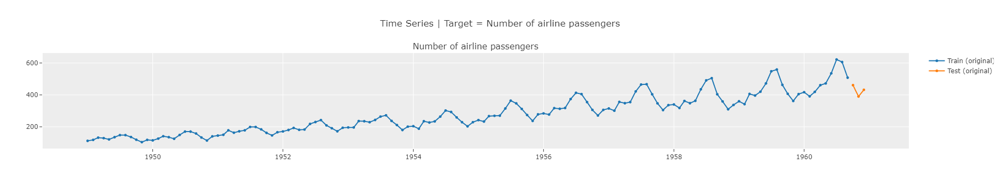

In [12]:
exp.plot_model(best, plot = 'train_test_split')

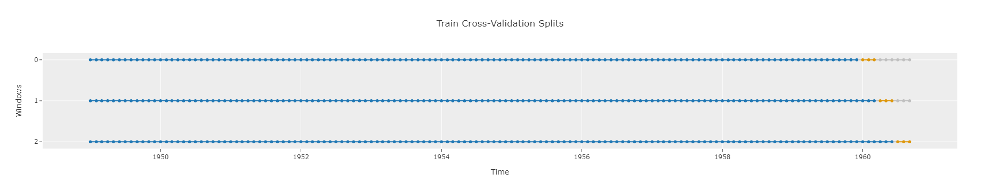

In [13]:
exp.plot_model(best, plot = 'cv')

#### Model Evaluation

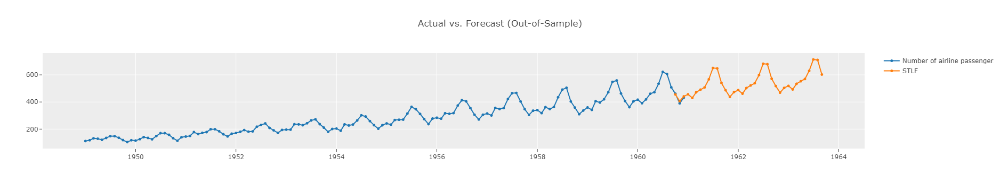

In [14]:
exp.plot_model(best, plot = 'forecast', data_kwargs = {'fh' : 36})

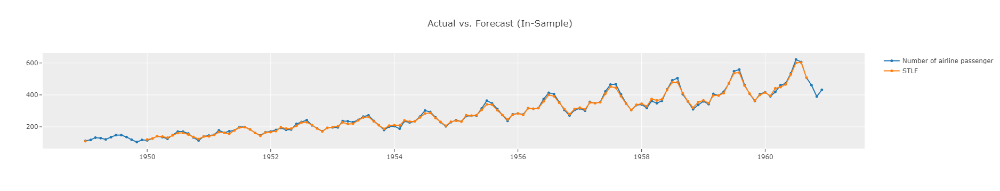

In [15]:
exp.plot_model(best, plot = 'insample')

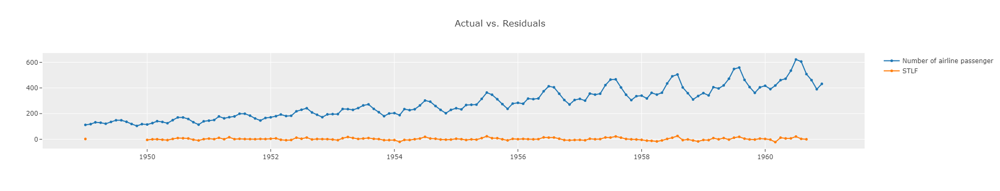

In [16]:
exp.plot_model(best, plot = 'residuals')

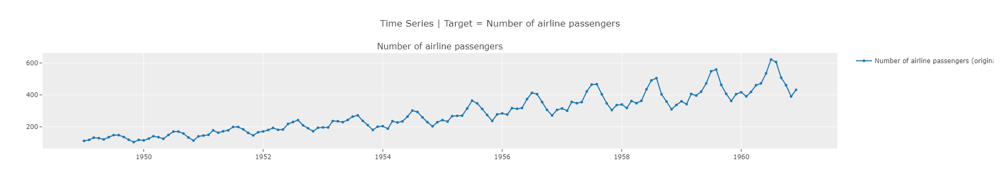

In [17]:
exp.plot_model(best, plot = 'ts')

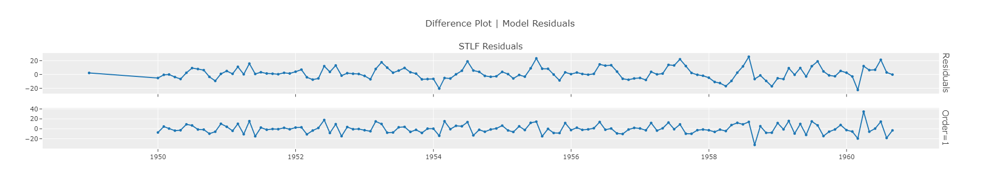

In [18]:
exp.plot_model(best, plot = 'diff')

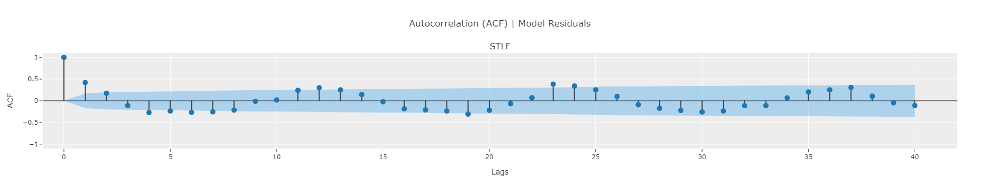

In [19]:
exp.plot_model(best, plot = 'acf')

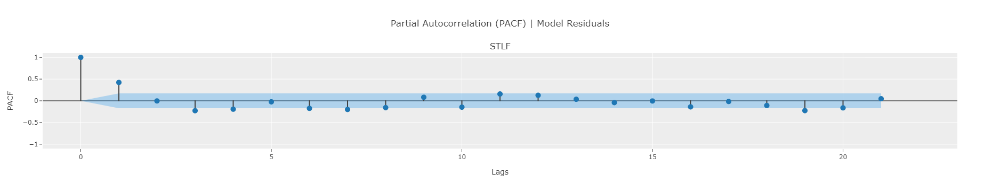

In [20]:
exp.plot_model(best, plot = 'pacf')

In [21]:
# exp.plot_model(best, plot = 'ccf')

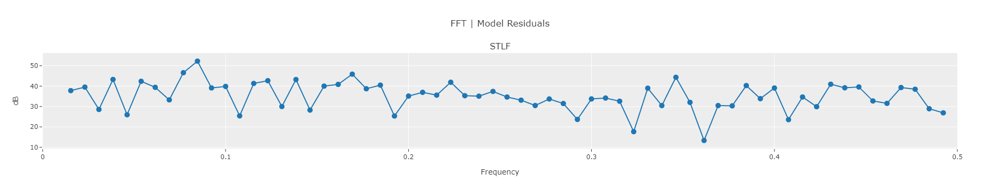

In [22]:
exp.plot_model(best, plot = 'fft')

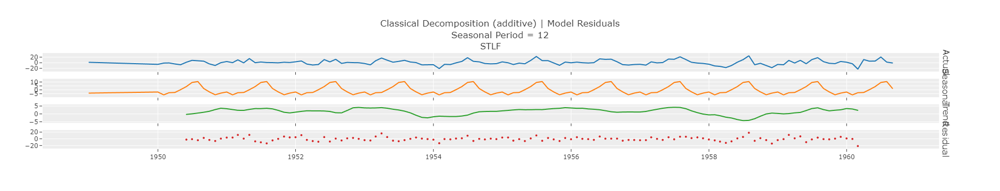

In [23]:
exp.plot_model(best, plot = 'decomp')

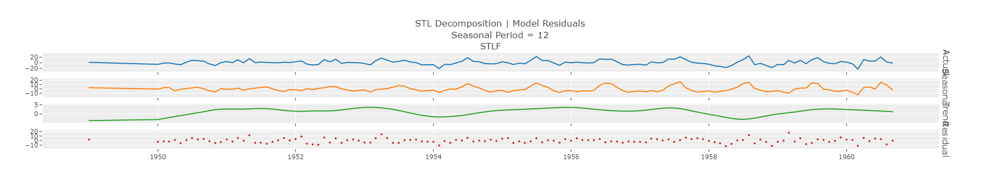

In [24]:
exp.plot_model(best, plot = 'decomp_stl')

## Prediction

In [25]:
holdout_pred = exp.predict_model(best)

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,STLF,0.3308,0.3162,10.5628,11.4671,0.0255,0.0252,0.8452


In [26]:
holdout_pred.head()

,y_pred
1960-10,455.3245
1960-11,406.4658
1960-12,441.5471


In [27]:
new_data_pred = exp.predict_model(best, fh = 36)
new_data_pred.head()

,y_pred
1960-10,455.3245
1960-11,406.4658
1960-12,441.5471
1961-01,456.2789
1961-02,430.1821
